# Prérequis

Ce notebook requiert les modules matplotlib, seaborn, plotly, ainsi que le module imgtools qui regroupe des fonctions nous avons crées pour ce projet.  
Le notebook utilise également le module 'tqdm' (https://github.com/tqdm/tqdm#readme). Si vous ne souhaitez pas le télécharger, laisser la valeur False ci-dessous, sinon la passer à True.

In [1]:
with_tqdm = True

# Initialisation

## Imports

In [2]:
# Modules usuels
import pandas as pd
import numpy as np
import random
import pickle
import math as m
import string
import warnings
from collections import defaultdict

# Modules graphiques
import matplotlib.pyplot as plt
import plotly as py
import plotly.figure_factory as ff
from plotly.offline import iplot
import plotly.graph_objects as go
import seaborn as sns
import cufflinks as cf

# Modules de traitement du texte
import re
import nltk
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer

# Modules additionnels
import imgtools as imt
if imt.version != 3:
    raise ImportError("Votre version de imgtools n'est pas la bonne !")
import txttools as txt
if txt.version != 1:
    raise ImportError("Votre version de txttools n'est pas la bonne !")
if with_tqdm:
    from tqdm import tqdm
else:
    def tqdm(it):
        return it

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\basti\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\basti\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


## Options

In [3]:
# Exceptions
warnings.simplefilter(action='ignore', category=FutureWarning) # pour sns.distplot

# Graphics
sns.set_style()
py.offline.init_notebook_mode(connected=False)
cf.go_offline(connected=False)

## Constantes

In [4]:
# Relative paths
PATH_DATAFRAME = "./trainset.csv"
PATH_TRAIN = "../images/image_train"
PATH_TEST = "../images/image_test"

# Extraction des données

In [5]:
# Chargement du jeu de données d'entrainement
df = pd.read_csv(PATH_DATAFRAME).set_index('productid')
display(df.head())

,designation,description,imageid,target
productid,,,,
3804725264,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,1263597046,0
436067568,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,1008141237,1
201115110,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,938777978,2
50418756,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,457047496,3
278535884,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,1077757786,4


In [6]:
# Chargement de la table de correspondance des labels
lab_enc = pd.read_csv('labels_encoding.csv')
display(lab_enc)

,prdtypecode,target,prdtype
0,10,0,livres_adulte
1,2280,1,magazines
2,50,2,accessoires_jeux_videos
3,1280,3,jouets_enfance
4,2705,4,livres_et_illustres
5,2522,5,papeterie
6,2582,6,mobilier_jardin_cuisine
7,1560,7,mobilier_interieur_litterie
8,1281,8,jeux_societe
9,1920,9,accessoires_interieur


# Distribution des classes

In [7]:
# Affichage de la distribution des classes
repartition = df['target'].astype('str').value_counts().sort_values(ascending=False)
repartition.iplot(kind='bar', colors='darkblue', xTitle="classes", yTitle="Nombre d'articles",
                  title= "Nombre d'articles en vente par classe")

Ce graphique illustre le déséquilibre entre les classes. Le rapport entre la classe majoritaire et les classes minoritaires est de 12 environ.

# Valeurs manquantes

## Vue globale

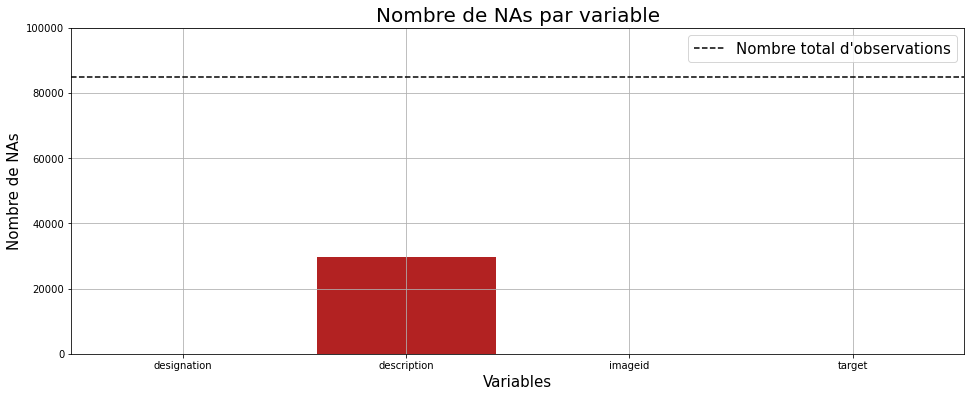

In [8]:
# Nombre de NAs par colonne
plt.figure(figsize=(16, 6))
plt.bar(x=df.columns, height=df.isna().sum(), color='firebrick')
plt.hlines(len(df), -0.5, 3.5, color='k', linestyle='dashed', label="Nombre total d'observations")
plt.axis([-0.5, 3.5, 0, 100000])
plt.title("Nombre de NAs par variable", fontsize=20)
plt.xlabel("Variables", fontsize=15)
plt.ylabel("Nombre de NAs", fontsize=15)
plt.legend(fontsize=15)
plt.grid('on')
plt.show();

Tous les articles mis en vente ont un champ 'designation' complété et une image associée, référencée par 'imageid'. Il doit s'agir de données obligatoires pour que l'article soit mis en vente.  
En revanche le champ 'description' doit être optionel, car il est vide pour environ 35% des articles.  
Enfin, on constate que toutes nos données sont bien étiquettées.

## Répartition des valeurs manquantes selon les classes

In [9]:
# Calcul des distributions de classes et des NAs
count_na = lambda x: x.isnull().sum()
func_gby = {'description': count_na, "imageid": 'count'}
cls_descr = df[['target', 'imageid', 'description']].groupby("target").agg(func_gby).reset_index()
cls_descr = cls_descr.rename({"description":"nb_nan_per_class", "imageid":"count_prod_per_class"}, axis=1)
cls_descr['%_nan'] = round((cls_descr["nb_nan_per_class"]/cls_descr['count_prod_per_class'])*100)
cls_descr['%Class'] = round((cls_descr["count_prod_per_class"]/len(df))*100)
cls_descr = cls_descr.set_index('target')

In [10]:
# Affichage
fig = go.Figure(data=[
    go.Bar(name='Articles', x=cls_descr.index, y=cls_descr["count_prod_per_class"]),
    go.Bar(name='NAs', x=cls_descr.index, y=cls_descr["nb_nan_per_class"])
])
# Change the bar mode
fig.update_layout(barmode='group', title_text="Valeurs manquantes par classe",
                  xaxis_title="Classes", yaxis_title="Nombre")
fig.show();

Il est clair que certaines classes de produits sont plus touchées que d'autres par les descriptions manquantes, notamment les classes 0, 1, 10, 16 (que nous avons respectivement intitulées 'livres_adultes, 'magazines', 'livres_jeunesse', 'cartes_a_jouer'). Ces types de produits sont certainement davantage vendus par des amateurs qui ne sont pas en mesure de fournir une description rigoureuse. De plus, le niveau de complexité et le prix relativement faibles de ces produits font peut-être qu'un acheteur se contenterait d'assez peu de détails.  
De manière générale, on peut supposer que pour des produits de faible complexité, l'essentiel des informations peut être condensé dans le champ 'designation', rendant le champ 'description' peu utile.

# Analyse du texte 

## Extraction des informations

In [11]:
# Extract text statistics
text_stats = pd.DataFrame(index=df.index)
text_stats['design_words_count'] = df['designation'].apply(txt.get_word_count)
text_stats['design_unique_words_count'] = df['designation'].apply(txt.get_unique_words)
text_stats['design_mean_word_length'] = df['designation'].apply(txt.get_mean_word_length)
text_stats['design_stopwords_count'] = df['designation'].apply(txt.get_stop_words_count)
text_stats['design_punctuation_count'] = df['designation'].apply(txt.get_punctuation_count)
text_stats['design_chars_count'] = df['designation'].apply(txt.get_chart_count)
text_stats['descr_words_count'] = df['description'].apply(txt.get_word_count)
text_stats['descr_unique_words_count'] = df['description'].apply(txt.get_unique_words)
text_stats['descr_mean_word_length'] = df['description'].apply(txt.get_mean_word_length)
text_stats['descr_stopwords_count'] = df['description'].apply(txt.get_stop_words_count)
text_stats['descr_punctuation_count'] = df['description'].apply(txt.get_punctuation_count)
text_stats['descr_chars_count'] = df['description'].apply(txt.get_chart_count)
display(text_stats.head())

,design_words_count,design_unique_words_count,design_mean_word_length,design_stopwords_count,design_punctuation_count,design_chars_count,descr_words_count,descr_unique_words_count,descr_mean_word_length,descr_stopwords_count,descr_punctuation_count,descr_chars_count
productid,,,,,,,,,,,,
3804725264,14,11,11,0,6,88,NaN,NaN,NaN,NaN,NaN,NaN
436067568,39,34,34,9,12,206,NaN,NaN,NaN,NaN,NaN,NaN
201115110,12,12,12,0,1,76,109.0,88.0,88.0,31.0,51.0,760.0
50418756,10,9,9,1,4,63,NaN,NaN,NaN,NaN,NaN,NaN
278535884,4,4,4,2,0,20,34.0,30.0,30.0,14.0,15.0,213.0


## Analyse des champs 'designation' et 'description' (pris séparément)

In [12]:
cols = ['design_words_count', 'design_unique_words_count', 'design_mean_word_length', 'design_stopwords_count']
text_stats[cols].iplot(kind='box', title= "Statistiques de la variable 'designation'")

Dans le champ 'designation', la médiane se situe à 10 mots. La dispersion est en général assez faible, mais certaines descriptions vont jusqu'à 50 mots.  
Si l'on regarde le nombre de mots uniques, on observe sensiblement la même chose, ce qui laisse supposer qu'il y a peu de cas de répétition.  
La longueur moyenne des mots est typiquement d'environ 10 caractères, mais certains vont jusqu'à plus de 40 caractères. Ces longs "mots" pourraient être en fait des références produit.  
Le nombre de stopwords (mots considérés d'emblée comme non informatifs) approche 0, mais dans certains cas on peut en trouver jusqu'à 20 environ. C'est assez étrange, mais on peut sans doute attribuer cela à l'aléa humain introduit par les utilisateurs.

In [13]:
cols = ['descr_words_count', 'descr_unique_words_count', 'descr_mean_word_length', 'descr_stopwords_count']
text_stats[cols].iplot(kind='box', title="Statistiques de la variable 'description'")

Dans le champ 'description', on a typiquement (intervalle interquartile) entre 40 et 160 mots. Cependant le maximum est d'environ 2000 mots.  
La longueur médiane des mots est typiquement (intervalle interquartile) entre 30 et 110 caractères, et cela peut aller jusqu'à plus de 700 caractères. On peut supposer que ces très longs "mots" sont en fait des références produit ou encore des URL de sites web.  

**Pour tous les résultats observés jusqu'ici, on constate que l'écart interquartile est relativement faible, mais que l'étendue du troisième quartile est beaucoup plus grande, ce qui indique la présence d'outliers.**

## Comparaison des champs 'designation' et 'description'

### Caractères

In [14]:
chars_counts = text_stats[['design_chars_count', 'design_punctuation_count', 'descr_chars_count', 'descr_punctuation_count']]
chars_counts.iplot(kind='box', title="Distributions du nombre de caractères dans 'designation' et 'description'")

Le champ 'designation' contient typiquement (intervalle interquartile) entre 40 à 90 caractères, et le maximum est de 250 caractères. Ce nombre de 250 n'est sans doute pas une coïncidence, mais une limite imposée aux utilisateur, ce champ étant destiné à être concis. La présence de ponctuation dans ce champ est assez étrange, mais reste exceptionnelle.  
Le champ 'description contient typiquement (intervalle interquartile) entre 300 et 1000 caractères, et le maximum est de plus de 12 000 caractères ! Il doit y avoir une limite de caractères mais elle est manifestement très grande. La ponctuation semble cohérente.


### Mots

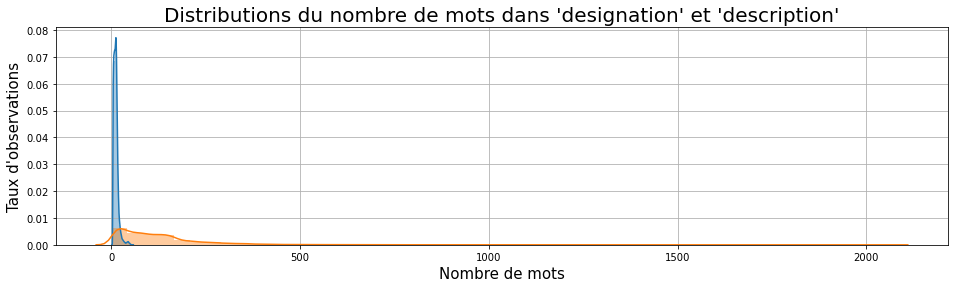

In [15]:
plt.figure(figsize=(16, 4))
sns.distplot(text_stats['design_words_count'], label='design_words_count')
sns.distplot(text_stats['descr_words_count'], label='descr_words_count')
plt.title("Distributions du nombre de mots dans 'designation' et 'description'", fontsize=20)
plt.xlabel("Nombre de mots", fontsize=15)
plt.ylabel("Taux d'observations", fontsize=15)
plt.grid('on')
plt.show();

Ce graphique permet de confirmer les observations précédentes.   
Le champ 'description' a une moyenne et surtout une dispersion considérablement supérieure à celles du champ 'designation'.  
De plus, les extrêmes observés pour le champ 'description' sont manifestement des outliers.

## Nettoyage des données textes

In [16]:
clean_text_data = False
save_text_data = False

FILE_TEXT_SAVE = "text_data_cleaned.csv"

# Nettoyage du texte
if clean_text_data:

    text_data = pd.DataFrame(data=df[['designation', 'description']], index=df.index)

    # Remplacement des caractères accentués
    text_data['clean_designation'] = text_data['designation'].apply(txt.remplace_accent)
    text_data['clean_description'] = text_data['description'].apply(txt.remplace_accent)

    # Stemming et suppression des balises HTML
    text_data['stem_designation'] = text_data['clean_designation'].apply(txt.cleaning_data)
    text_data['stem_description'] = text_data['clean_description'].apply(txt.cleaning_data)

    # Fusion des deux champs dans un corpus
    text_data['clean_corpus'] = text_data.apply(lambda x: txt.corpus(x['clean_description'], x['clean_designation']), axis=1)
    text_data['stem_corpus'] = text_data.apply(lambda x: txt.corpus(x['stem_description'], x['stem_designation']), axis=1)

    
# Sauvegarde
if save_text_data:
    text_data.to_csv(FILE_TEXT_SAVE, index=True)

In [17]:
FILE_LOAD_SAVE = "text_data_cleaned.csv"

text_data = pd.read_csv(FILE_LOAD_SAVE, index_col=0)
display(text_data.head())

,designation,description,clean_designation,clean_description,stem_designation,stem_description,clean_corpus,stem_corpus
productid,,,,,,,,
3804725264,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,olivi : personalisiert notizbuch / 150 seiten ...,NaN,Olivia: Personalisiertes Notizbuch / 150 Seite...,olivi : personalisiert notizbuch / 150 seiten ...
436067568,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,journal de art ( le ) n° 133 du 28/09/2001 - l...,NaN,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,journal de art ( le ) n° 133 du 28/09/2001 - l...
201115110,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,grand stylet ergonom bleu gamepad nintendo wii...,pilot styl touch pen marqu speedlink 1 stylet ...,PILOT STYLE Touch Pen de marque Speedlink est ...,pilot styl touch pen marqu speedlink 1 stylet ...
50418756,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,peluch donald - europ - disneyland 2000 ( mari...,NaN,Peluche Donald - Europe - Disneyland 2000 (Mar...,peluch donald - europ - disneyland 2000 ( mari...
278535884,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,La Guerre Des Tuques,Luc a des idees de grandeur. Il veut organiser...,la guerr de tuqu,luc a ide grandeur . il veut organis jeu guerr...,Luc a des idees de grandeur. Il veut organiser...,luc a ide grandeur . il veut organis jeu guerr...


## Analyse des unigrammes et bigrammes pour l'ensemble de deux champs

### Globalement

No handles with labels found to put in legend.


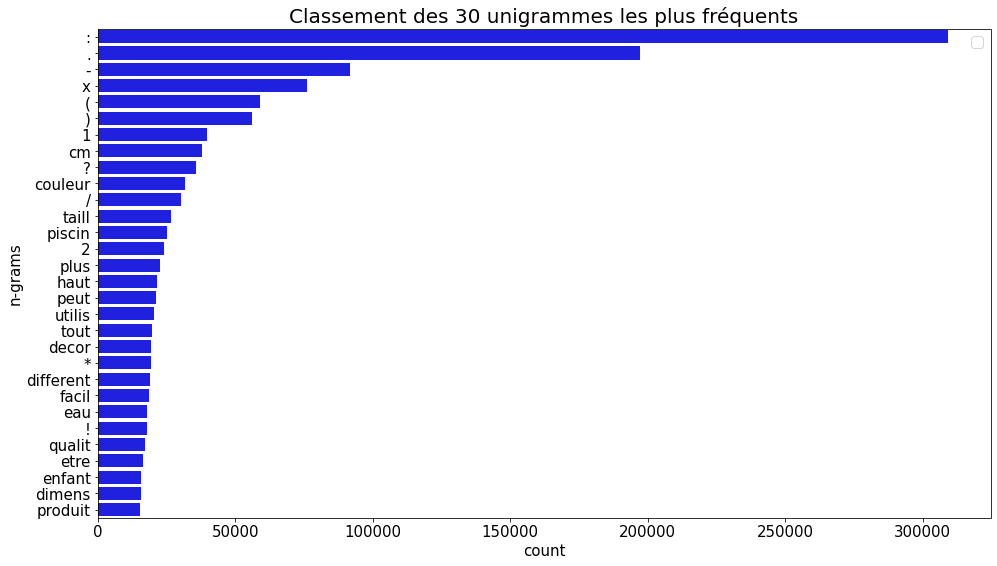

In [18]:
# Unigrammes (pour l'ensemble des deux champs)
unigrams_corpus = defaultdict(int) 
for text in text_data['stem_corpus']:
    for word in txt.generate_ngrams(text, 1):
        unigrams_corpus[word] += 1
        
txt.plot_ngrams(unigrams_corpus, size=30, title="Classement des 30 unigrammes les plus fréquents", color='b')

No handles with labels found to put in legend.


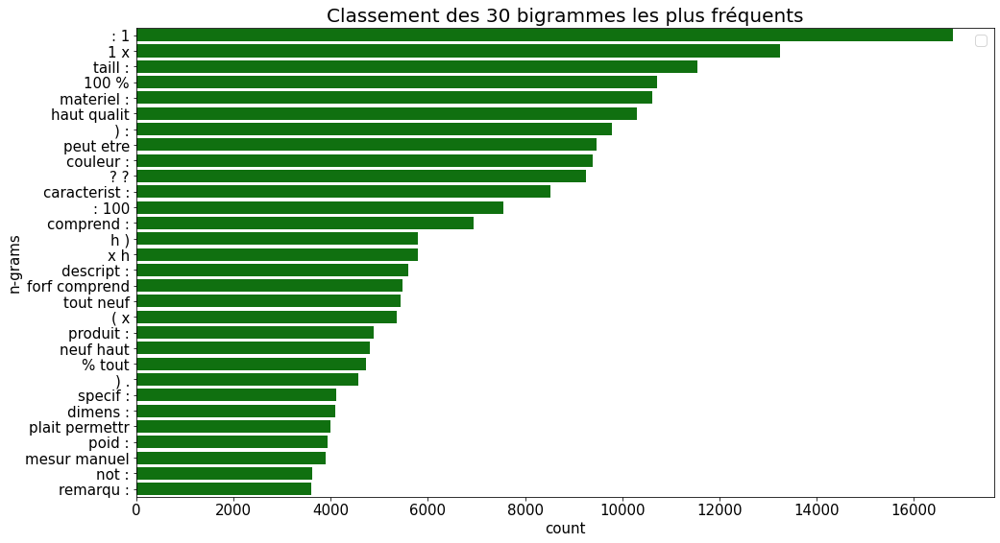

In [19]:
# Bigrammes (pour l'ensemble des deux champs)
bigrams_corpus = defaultdict(int) 
for text in text_data['stem_corpus']:
    for word in txt.generate_ngrams(text, 2):
        bigrams_corpus[word] += 1

txt.plot_ngrams(bigrams_corpus, size=30, title="Classement des 30 bigrammes les plus fréquents", color='g')

### Par classe

100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


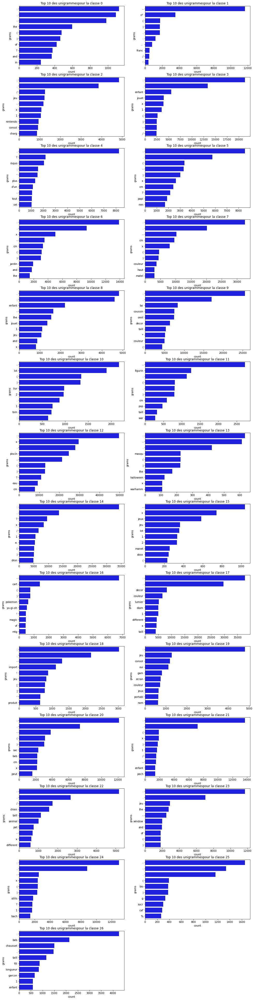

In [20]:
# Unigrammes par classe (pour l'ensemble des deux champs)
unigrams_per_class = {}

for label in tqdm(lab_enc['target']):
    
    unigrams_per_class[label] = defaultdict(int)
   
    for text in text_data[df['target']==label]['stem_corpus'].dropna():
        for word in txt.generate_ngrams(text, 1):
            unigrams_per_class[label][word] += 1
            
txt.plot_ngrams_class(unigrams_per_class, size=10, title="Top 10 des unigrammes",
                      subplots=(14,2), color='b', figsize=(16,70))

On remarque que certaines classes contiennent principalement des mots en anglais (e.g. classe 0).  
Certaines classes se distinguent bien par des unigrammes caractéristiques, c'est le cas notammenet pour els classes 1  3, 9, 11, 13, 16 , 25.  
On peut remarquer qu'il y a encore du nettoyage à faire dans les données. Il faudrait par exemple retirer les "mots": x, cm, jeu , 1, and , of, the.  
*Certaines classes partagent des unigrammes avec d'autres. Voyons si avec des bigrammes on arrive à un meilleur résultat.*

100%|██████████| 27/27 [00:21<00:00,  1.27it/s]


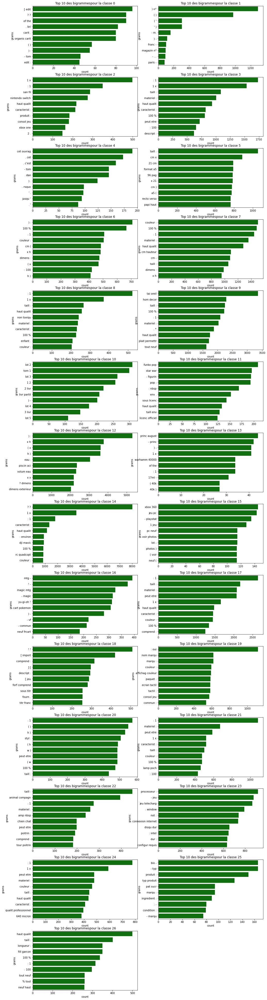

In [21]:
# Bigrammes par classe (pour l'ensemble des deux champs)
bigrams_per_class ={}
for label in tqdm(lab_enc['target']):
    
    bigrams_per_class[label] = defaultdict(int)
   
    for text in text_data[df['target']==label]['stem_corpus'].dropna():
        for word in txt.generate_ngrams(text, 2):
            bigrams_per_class[label][word] += 1
            
txt.plot_ngrams_class(bigrams_per_class, size=10, title="Top 10 des bigrammes",
                      subplots=(14,2), color='g', figsize=(16,70))

Les bigrammes apportent une meilleure caractérisation des classes.  
L'analyse des bigrammes confirme par exemple qu'il faut nettoyer les "x 1", qui sont présents arbitrairement dans certaines classes, et n'apportent aucune information classifiante.

### Lequel des champs 'designation' vs 'description' donne le plus d'information ?

#### Unigrammes par classe

In [22]:
# Bigrammes par classe pour le champ 'designation'
bigrams_desi_per_class = {}

for label in tqdm(lab_enc['target']):
    
    bigrams_desi_per_class[label] = defaultdict(int)
   
    for text in text_data[df['target']==label]['stem_designation'].dropna():
        for word in txt.generate_ngrams(text, 2):
            bigrams_desi_per_class[label][word] += 1

100%|██████████| 27/27 [00:03<00:00,  7.94it/s]


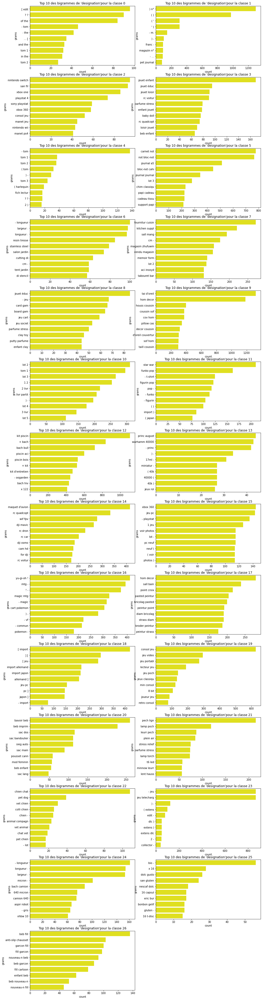

In [23]:
txt.plot_ngrams_class(bigrams_desi_per_class, size=10, title="Top 10 des bigrammes de 'designation'",
                      subplots=(14,2), color='yellow', figsize=(16,70))

#### Bigrammes par classe

In [24]:
# Bigrammes par classe pour le champ 'description'
bigrams_desc_per_class ={}

for label in tqdm(lab_enc['target']):
    
    bigrams_desc_per_class[label] = defaultdict(int)
   
    for text in text_data[df['target']==label]['stem_description'].dropna():
        for word in txt.generate_ngrams(text, 2):
            bigrams_desc_per_class[label][word] += 1

100%|██████████| 27/27 [00:18<00:00,  1.44it/s]


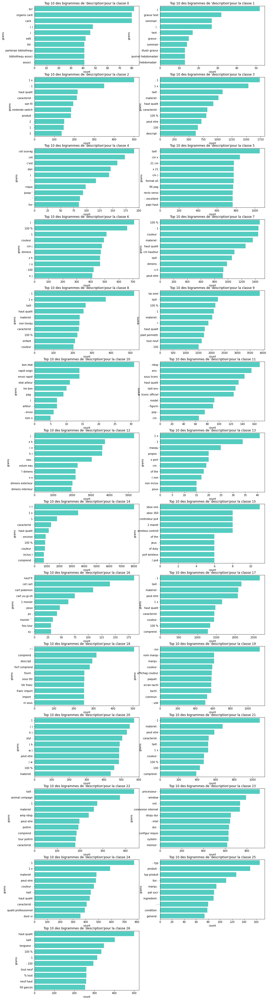

In [25]:
txt.plot_ngrams_class(bigrams_desc_per_class, size=10, title="Top 10 des bigrammes de 'description'",
                      subplots=(14,2), color='turquoise', figsize=(16,70))

## Conclusion pour la partie texte

La colonne 'description' est celle qui contient le plus de bruit avec des mots inutiles, mais c'est celle qui contient le plus de données par ligne.  
La colonnes designation quant à elle contient des données plus propres, les bigrammes obtenus caractérisent assez bien les classes. Les données de cette colonne sont d'une meilleure qualité, mais sont-elles suffisantes ?  
Réflexion : devrons-nous entrainer également notre modèle uniquement avec la colonne 'designation' ?